# Loading data

In [1]:
import pandas as pd
import functools
import plotly.express as px
import json

In [11]:
#cities = ["Saas-Fee", "Arosa", "Laax","Belp","Saanen","Adelboden", "Andermatt", "Davos", "Bulle", "Bern", "Genève", "Lausanne", "Zürich", "Neuchâtel", "Sion", "St. Gallen", "Appenzell", "Solothurn", "Zug", "Fribourg", "Luzern", "Ecublens (VD)", "Kloten", "Le Grand-Saconnex", "Nyon", "Zermatt", "Lugano"]

compression = ".xz"
folder = os.path.join(".","data")
if not(os.path.exists(folder)):
    print("ERROR, data folder not found")

def file_path(file_name: str) -> str:
    return os.path.join(folder, file_name)

list_of_cities_path = file_path("CityList.json")


with open(list_of_cities_path, "r") as filehandle:
    cities = json.load(filehandle)

density = dict()
demographics = dict()
tiles = dict()
demographicsDaily = {"All": dict() ,"Male": dict(), "Age": dict()}
for city in cities:
    tiles_path = file_path(f'{city}Tiles.pkl{compression}')
    hourly_dem_path = file_path(f'{city}HourlyDemographics.pkl{compression}')
    hourly_density_path = file_path(f'{city}HourlyDensity.pkl{compression}')
    daily_density_path = file_path(f'{city}DensityDaily.pkl{compression}')
    daily_demographics_path = file_path(f'{city}DemographicsDaily.pkl{compression}')
    density[city] = pd.read_pickle(hourly_density_path)
    demographics[city] = pd.read_pickle(hourly_dem_path)
    demographicsDaily["All"][city] = pd.read_pickle(daily_demographics_path)
    tiles[city] = pd.read_pickle(tiles_path)
    tiles[city]['lat'] = (tiles[city]['ll_lat'] + tiles[city]['ur_lat'])/2
    tiles[city]['lon'] = (tiles[city]['ll_lon'] + tiles[city]['ur_lon'])/2

In [222]:
for c in cities:
    city =  c
    df = tiles[city].set_index("tileID").join(demographics[city]).reset_index().set_index("tileID")[["time", "lat", "lon", "male_proportion"]]
    df1 = df.reset_index().set_index(["tileID",'time']).join(density[city])
    df1.reset_index("time").sort_values("time").to_csv(f'./csvData/Joined{c}.csv')
    density[c].to_csv(f'./csvData/{c}.csv')
    tiles[c].to_csv(f'./csvData/Tiles{c}.csv')

In [223]:
density["Arosa"]

score
tileID   time                      
45512400 2020-01-27T00:00:00     40
         2020-01-27T01:00:00     52
         2020-01-27T02:00:00     53
         2020-01-27T03:00:00     53
         2020-01-27T04:00:00     53
...                             ...
45378931 2020-01-27T15:00:00     23
45378932 2020-01-27T13:00:00     22
         2020-01-27T14:00:00     24
         2020-01-27T15:00:00     22
45388457 2020-01-27T15:00:00     21

[2196 rows x 1 columns]

In [224]:
demographicsDaily

{'All': {'Saas-Fee':           ageDistribution  maleProportion
  27689025              NaN        0.479284
  27666702              NaN        0.491946
  27659265              NaN        0.493956
  27681584              NaN        0.493918
  27674142              NaN        0.495604
  27696467              NaN        0.488277
  27681583              NaN        0.498315
  27674141              NaN        0.475604
  27651826              NaN        0.485422
  27644390              NaN        0.481766
  27659263              NaN        0.480411
  27636955              NaN        0.480692
  27703911              NaN        0.502566
  27659264              NaN        0.503962
  27681582              NaN        0.481092
  27636954              NaN        0.472902
  27666703              NaN        0.494663
  27651827              NaN        0.502669
  27644389              NaN        0.486901
  27689024              NaN        0.484854
  27674143              NaN        0.482279,
  'Arosa':  

In [225]:
demographicsDaily['All']['Arosa']

,ageDistribution,maleProportion
45512400,NaN,0.480737
45579215,NaN,0.484791
45493320,NaN,0.516671
45569666,NaN,0.498447
45483782,NaN,0.52177
45521945,NaN,0.477103
45569667,NaN,0.474215
45579214,NaN,0.489675
45531487,NaN,0.498778
45541028,NaN,0.465527


In [226]:
city = "Ecublens (VD)"
df = tiles[city].set_index("tileID").join(demographics[city]).reset_index().set_index("tileID")[["time", "lat", "lon", "male_proportion"]]

In [227]:
density[city]

score
tileID   time                      
23363547 2020-01-27T00:00:00     25
         2020-01-27T01:00:00     34
         2020-01-27T02:00:00     35
         2020-01-27T03:00:00     36
         2020-01-27T04:00:00     36
...                             ...
23630919 2020-01-27T22:00:00     22
23452502 2020-01-27T20:00:00     21
         2020-01-27T21:00:00     22
         2020-01-27T22:00:00     21
23445652 2020-01-27T21:00:00     21

[6088 rows x 1 columns]

In [228]:
df.reset_index().set_index(["tileID",'time']).join(density[city])

lat       lon  male_proportion  score
tileID   time                                                            
23356712 2020-01-27T10:00:00  46.513564  6.549327         0.510795     45
         2020-01-27T11:00:00  46.513564  6.549327         0.495532     44
         2020-01-27T12:00:00  46.513564  6.549327         0.486298     43
         2020-01-27T13:00:00  46.513564  6.549327         0.491918     45
         2020-01-27T14:00:00  46.513564  6.549327         0.500708     47
...                                 ...       ...              ...    ...
23699716 2020-01-27T19:00:00  46.539861  6.576272         0.522593     59
         2020-01-27T20:00:00  46.539861  6.576272         0.514753     59
         2020-01-27T21:00:00  46.539861  6.576272         0.521467     65
         2020-01-27T22:00:00  46.539861  6.576272         0.524791     66
         2020-01-27T23:00:00  46.539861  6.576272         0.540118     51

[3484 rows x 4 columns]

In [229]:
city =  "Zürich"
df = tiles[city].set_index("tileID").join(demographics[city]).reset_index().set_index("tileID")[["time", "lat", "lon", "male_proportion"]]
df1 = df.reset_index().set_index(["tileID",'time']).join(density[city])
df1.reset_index("time").sort_values("time")

,time,lat,lon,male_proportion,score
tileID,,,,,
43354497,2020-01-27T00:00:00,47.378950,8.538379,0.436978,146
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
...,...,...,...,...,...
43149877,2020-01-27T23:00:00,47.371018,8.521003,0.536346,97
43307945,2020-01-27T23:00:00,47.372629,8.540897,0.469303,96
43010639,2020-01-27T23:00:00,47.363910,8.511591,0.512977,50


In [230]:
fig = px.scatter_mapbox(df1.reset_index("time").sort_values("time"), lat="lat", lon="lon", color="male_proportion",
                        animation_frame="time", size="score", range_color = [df1.male_proportion.min(),df1.male_proportion.max() ],
                  color_continuous_scale=px.colors.cyclical.IceFire_r, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [231]:
import seaborn as sns
import seaborn as sbn
import numpy as np
import matplotlib.pyplot as plt
sns.set_theme()

In [232]:
for c in cities:
    density[c]['city'] = c

res = pd.DataFrame(columns=['score','city'])
count = 0

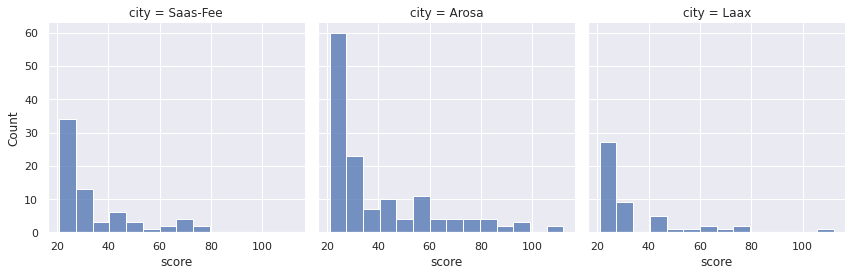

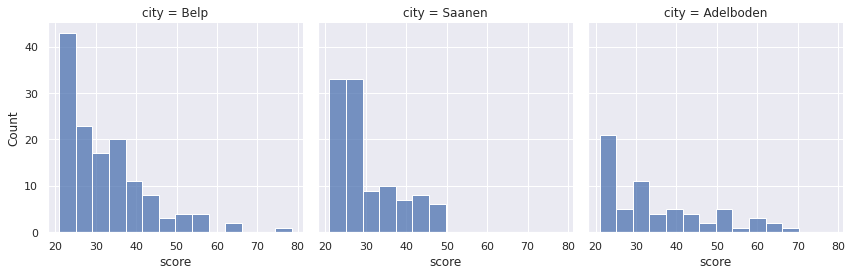

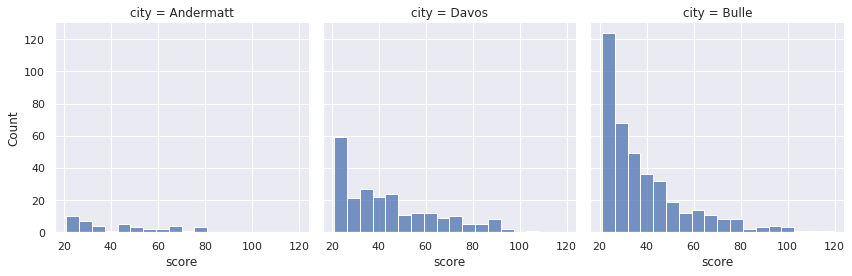

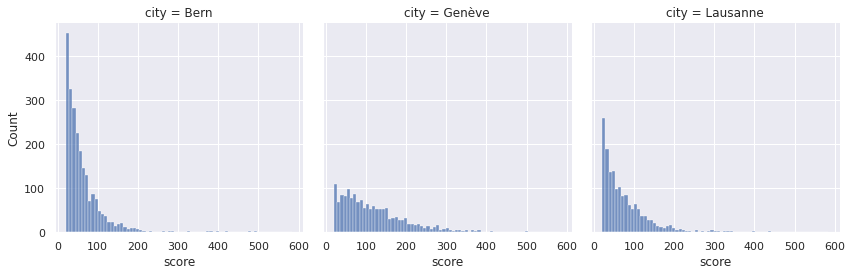

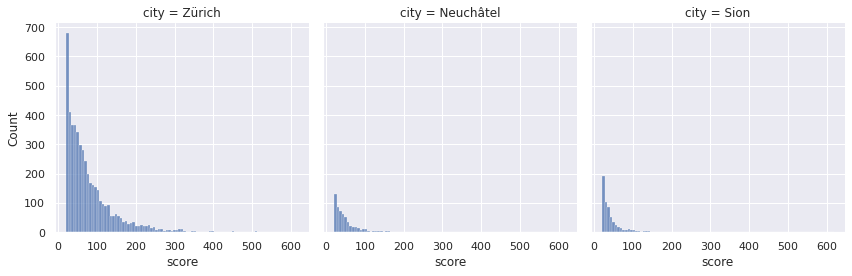

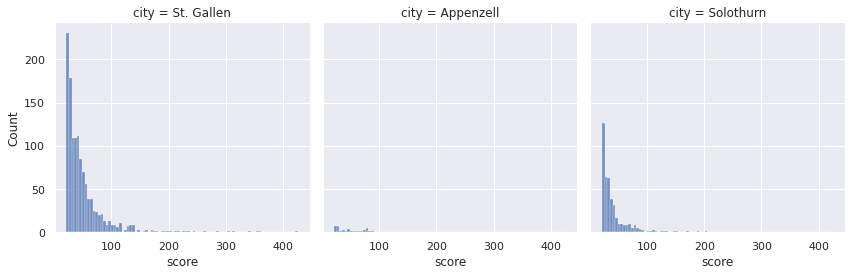

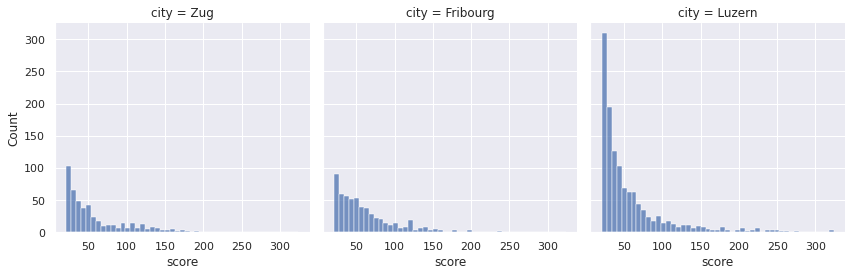

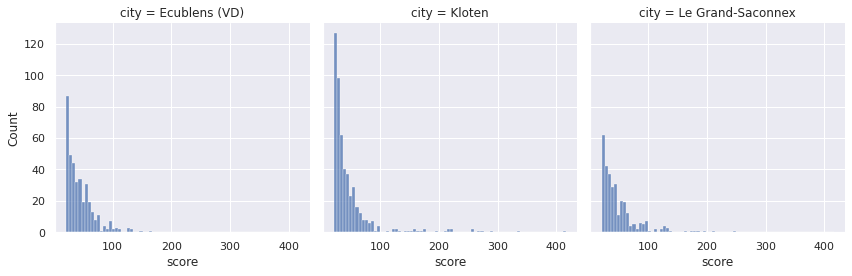

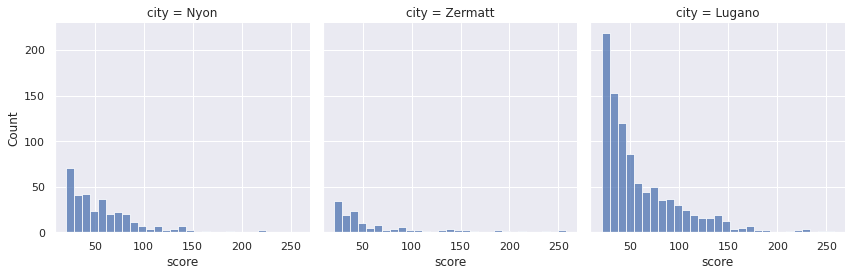

In [233]:
for c in cities:
    d = density[c].reset_index().groupby("tileID").mean()
    d['city'] = c
    res = res.append(d[['score', "city"]])
    count += 1
    if count%3 ==0:
        sbn.displot(res, x="score", col="city", height=4)
        count= 0
        res = pd.DataFrame(columns=['score','city'])

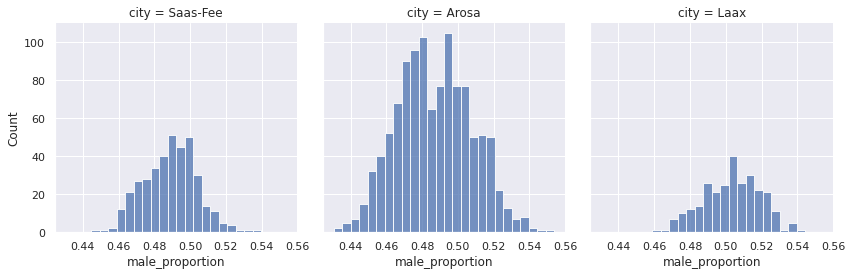

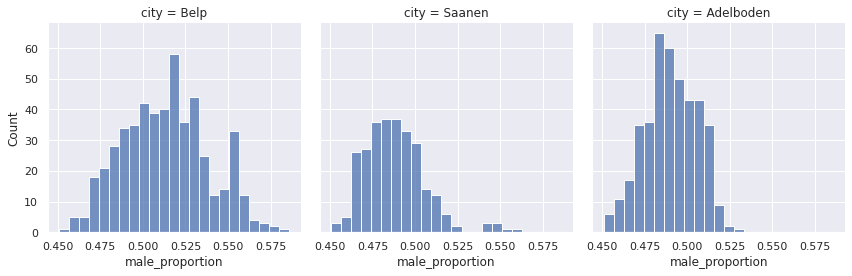

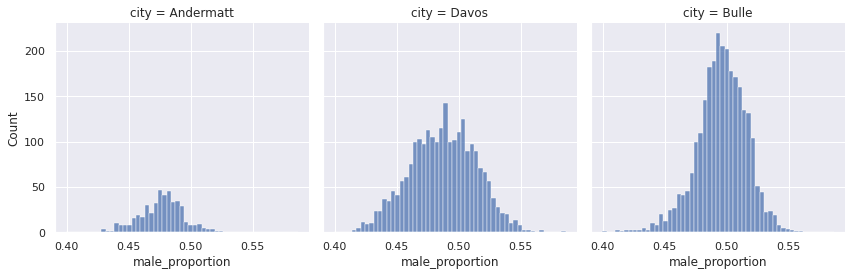

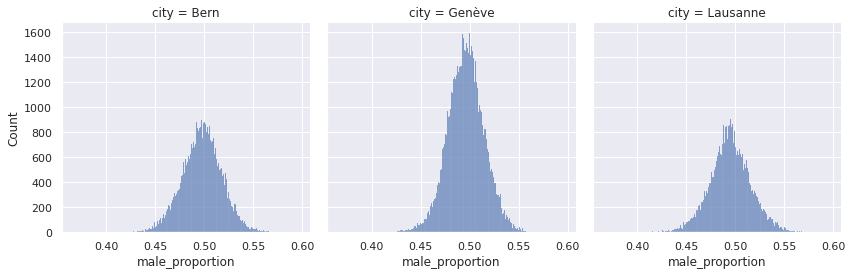

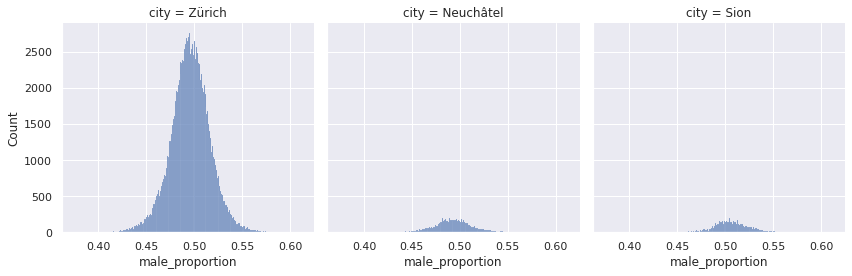

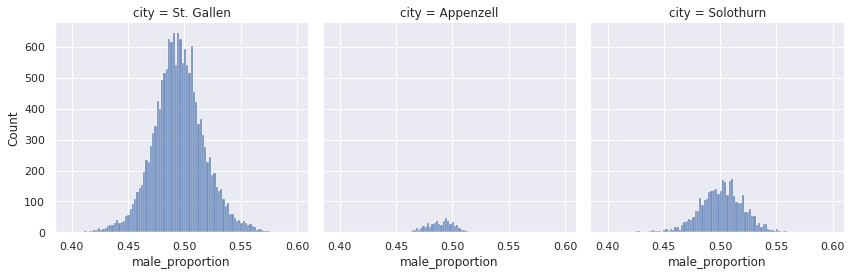

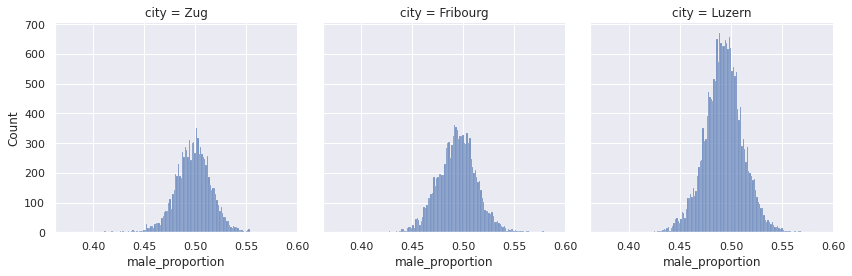

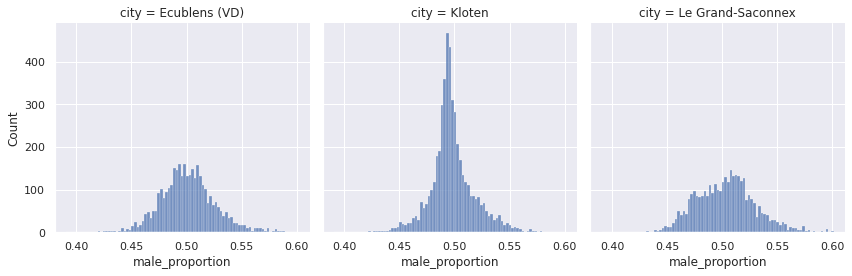

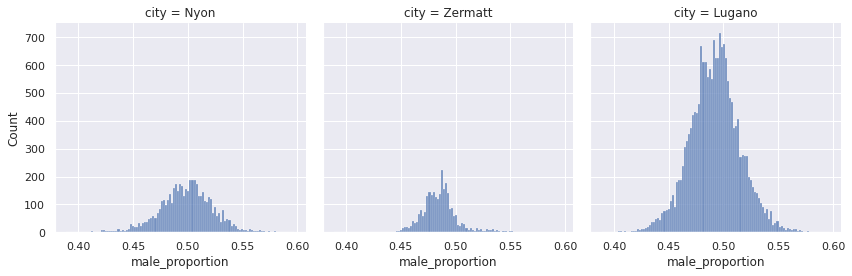

In [234]:
for c in cities:
    demographics[c]['city'] = c

res = pd.DataFrame(columns=['male_proportion','city'])
count = 0
for c in cities:
    res = res.append(demographics[c].reset_index()[['male_proportion', "city"]])
    count += 1
    if count%3 ==0:
        sbn.displot(res, x="male_proportion", col="city", height=4)
        count= 0
        res = pd.DataFrame(columns=['male_proportion','city'])

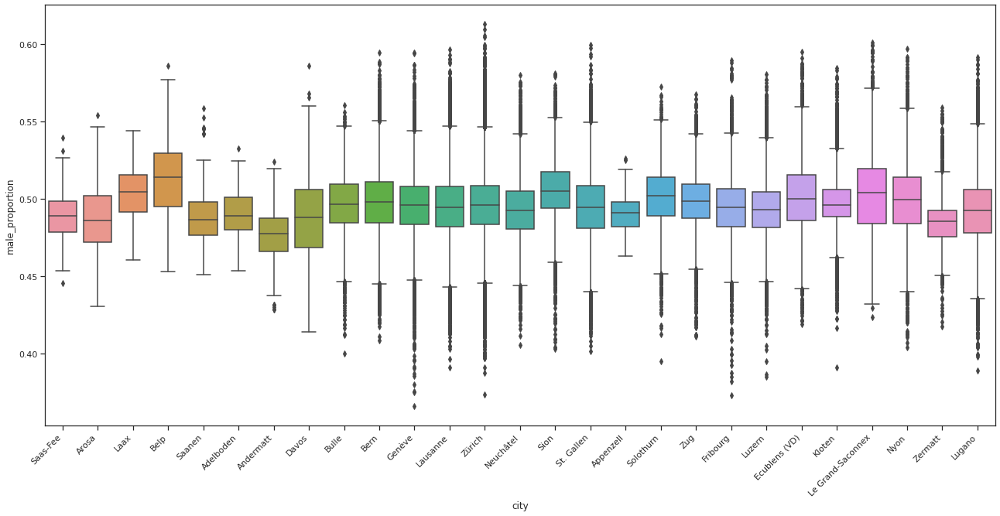

In [235]:

res = pd.DataFrame(columns=['male_proportion','city'])
for c in cities:
    res = res.append(demographics[c].reset_index()[['male_proportion', "city"]])
    
sns.set_theme(style="ticks", palette="pastel")
fig = plt.gcf()
fig.set_size_inches(22, 10)
chart = sns.boxplot(x="city", y="male_proportion",
            data=res, )
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

In [236]:
city = "Ecublens (VD)"
fig = px.scatter_mapbox(tiles["Bulle"].set_index("tileID").join(demographics["Bulle"]).reset_index().set_index("tileID")[["time", "ll_lat", "ll_lon", "male_proportion"]], lat="ll_lat", lon="ll_lon", color="male_proportion", 
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [237]:
city = "Ecublens (VD)"
fig = px.scatter_mapbox(demographics[city].reset_index().set_index("tileID").groupby("tileID").mean()[["male_proportion"]].join(tiles[city].set_index("tileID")), lat="ll_lat", lon="ll_lon", color="male_proportion",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [238]:
res = pd.DataFrame(columns=["maleProportion"])
for c in cities:
    res = res.append(pd.DataFrame(demographicsDaily['All'][c]["maleProportion"][demographicsDaily['All'][c]["maleProportion"].notna()]))

In [239]:
res

,maleProportion
27689025,0.479284
27666702,0.491946
27659265,0.493956
27681584,0.493918
27674142,0.495604
...,...
33159265,0.481459
33265218,0.492559
33012836,0.477482
33126691,0.504783


In [240]:
res["maleProportion"].std()

0.01755443308382538

In [241]:
res["maleProportion"].mean()

0.4963322828640363

In [242]:
px.box( res["maleProportion"])

In [243]:
# ["Andermatt", "Davos", "Bulle", "Bern", "Genève", "Lausanne", "Zurich", "Neuchâtel", "Sion", "St. Gallen", "Appenzell", "Solothurn", "Zug", "Fribourg", "Luzern", "Ecublens (VD)"]

res = pd.DataFrame(columns=['male_proportion', "time", 'city'])
for c in ["Bern", "Genève", "Lausanne", "Zürich", "Neuchâtel", "Ecublens (VD)", "Andermatt", "Davos", "Zermatt"]:
    r = demographics[c].reset_index()[["time", "male_proportion"]]
    r['time'] = r['time'].map(lambda t : t.split("T")[1].split(":")[0])
    r["city"] = c
    res = res.append(r)

<AxesSubplot:xlabel='time', ylabel='male_proportion'>

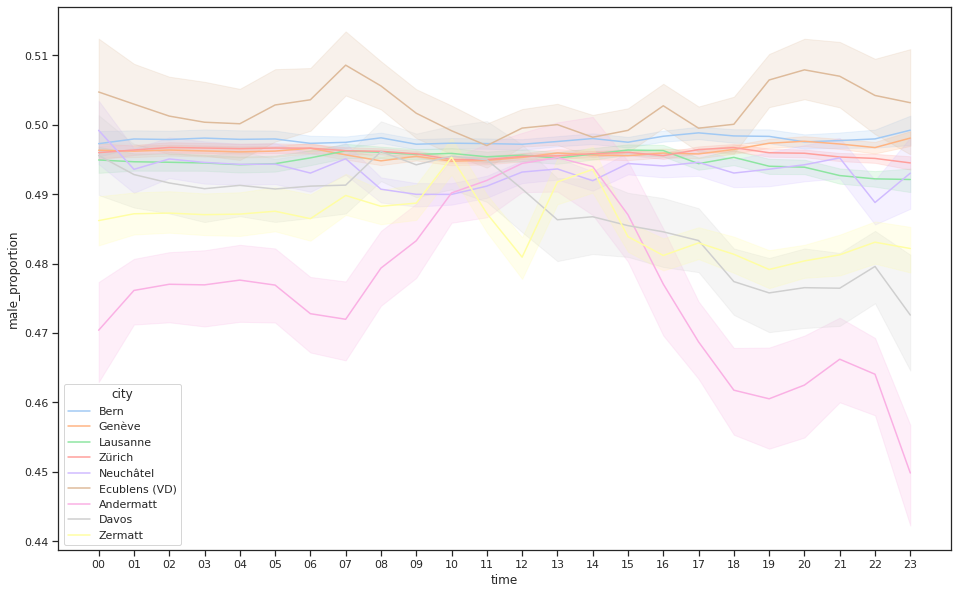

In [244]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
sns.lineplot(x="time", y="male_proportion",
            data=res, hue = "city")

# Silimarity

<AxesSubplot:xlabel='time', ylabel='score'>

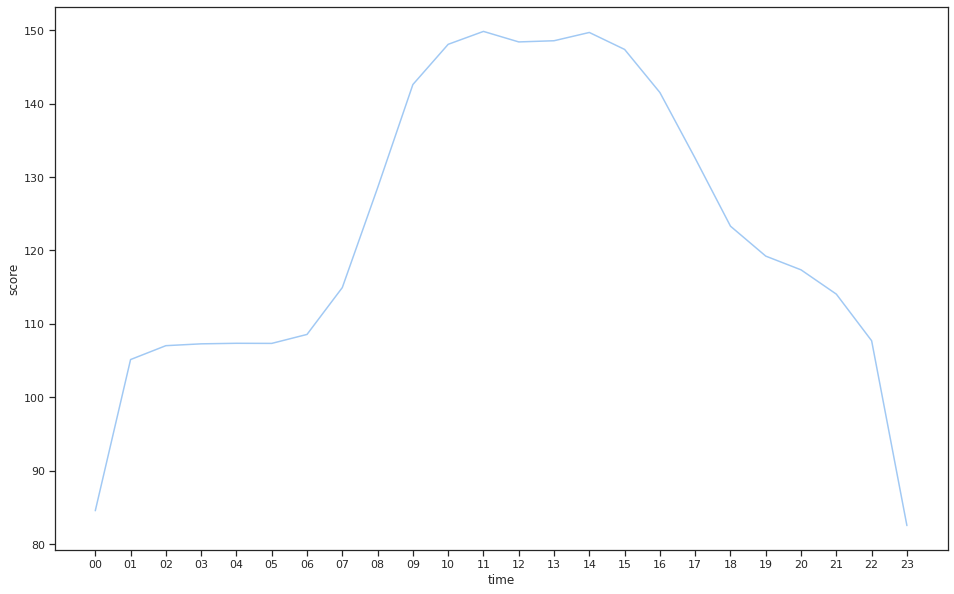

In [245]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
res=density["Genève"].reset_index().groupby("time").mean().reset_index()
res['time'] = res['time'].map(lambda t : t.split("T")[1].split(":")[0])
sns.lineplot(data=res, x="time", y="score")

In [312]:
allDensity = pd.DataFrame(columns=["tileID", "time", "score", "city"])
allDensity = allDensity.set_index(["tileID", "time"])

for c in density:
    normalDensity = density[c].copy()
    normalDensity = normalDensity.reset_index().groupby(["time", "city"]).mean().reset_index()[["time", "city", "score"]]
    normalDensity["score"] = (normalDensity.score ) / (normalDensity.score.max())
    allDensity = allDensity.append(normalDensity)
    
allDensity['time'] = allDensity['time'].map(lambda t : t.split("T")[1].split(":")[0])
allDensity.time = pd.to_numeric(allDensity.time)

<AxesSubplot:xlabel='time', ylabel='score'>

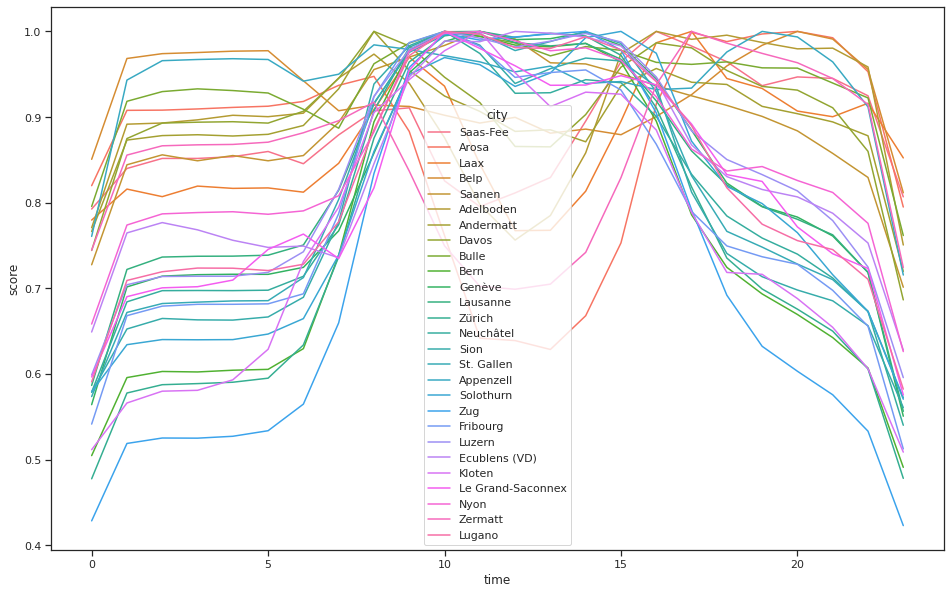

In [313]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
sns.lineplot(x="time", y="score",
            data=allDensity, hue = "city")

In [314]:
fig = px.line(allDensity, x="time", y="score", color = "city")
fig.show()

In [315]:
res = demographics["Zürich"].dropna().groupby(["age_cat"]).mean().reset_index()

In [316]:
np.vstack([np.array([np.append(res["age_distribution"].to_numpy(),res["male_proportion"].to_numpy()).tolist()]), np.array([np.append(res["age_distribution"].to_numpy(),res["male_proportion"].to_numpy()).tolist()])])

array([[0.18162162, 0.27834503, 0.37291478, 0.16711857, 0.49565097,
        0.49565097, 0.49565097, 0.49565097],
       [0.18162162, 0.27834503, 0.37291478, 0.16711857, 0.49565097,
        0.49565097, 0.49565097, 0.49565097]])

In [317]:
demographics["Andermatt"]#.fillna(-1).groupby(["age_cat"]).mean().reset_index()

age_cat age_distribution  male_proportion  \
tileID   time                                                            
36497355 2020-01-27T00:00:00    None             None         0.480743   
         2020-01-27T01:00:00    None             None         0.479374   
         2020-01-27T02:00:00    None             None         0.479589   
         2020-01-27T03:00:00    None             None         0.479890   
         2020-01-27T04:00:00    None             None         0.480757   
...                              ...              ...              ...   
36480267 2020-01-27T21:00:00    None             None         0.487265   
         2020-01-27T22:00:00    None             None         0.482273   
36497357 2020-01-27T08:00:00    None             None         0.475887   
         2020-01-27T09:00:00    None             None         0.477819   
36505901 2020-01-27T08:00:00    None             None         0.482120   

                                   city  
tileID   time                            
36497355 2020-01-27T00:00:00  Andermatt  
         2020-01-27T01:00:00  Andermatt  
         2020-01-27T02:00:00  Andermatt  
         2020-01-27T03:00:00  Andermatt  
         2020-01-27T04:00:00  Andermatt  
...                                 ...  
36480267 2020-01-27T21:00:00  Andermatt  
         2020-01-27T22:00:00  Andermatt  
36497357 2020-01-27T08:00:00  Andermatt  
         2020-01-27T09:00:00  Andermatt  
36505901 2020-01-27T08:00:00  Andermatt  

[455 rows x 4 columns]

In [318]:
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler

In [343]:
# create vector representation

start  = True
for c in cities:
    print(c)
    res = demographics[c].dropna().groupby(["age_cat"]).mean().reset_index()
    temp =  res["male_proportion"].to_numpy()
    if len(temp) == 0:
        temp = np.zeros(4)+0.5
    res = density[c].reset_index().groupby("time").mean().reset_index()
    res['time'] = res['time'].map(lambda t : t.split("T")[1].split(":")[0])
    print(len(res['time']))
    temp = np.append(temp, res['score']/res["score"].max())
    if start:
        start = False
        vector_repr = np.array([temp.tolist()])
    else:
        print(vector_repr)
        vector_repr= np.vstack([vector_repr, np.array([temp.tolist()])])

Saas-Fee
24
Arosa
24
[[0.5        0.5        0.5        0.5        0.79260846 0.83995906
  0.85169825 0.85169825 0.85372225 0.85979424 0.84550962 0.87918274
  0.90729987 0.91075316 0.82552121 0.79543111 0.81142069 0.82943427
  0.89525468 0.96467177 1.         0.98293426 0.96463732 0.93663068
  0.9468406  0.94516197 0.92482653 0.80685405]]
Laax
24
[[0.5        0.5        0.5        0.5        0.79260846 0.83995906
  0.85169825 0.85169825 0.85372225 0.85979424 0.84550962 0.87918274
  0.90729987 0.91075316 0.82552121 0.79543111 0.81142069 0.82943427
  0.89525468 0.96467177 1.         0.98293426 0.96463732 0.93663068
  0.9468406  0.94516197 0.92482653 0.80685405]
 [0.47775145 0.47775145 0.47775145 0.47775145 0.81989179 0.90783655
  0.90807799 0.90947075 0.91126144 0.9126542  0.91822523 0.93705074
  0.94751006 0.88320732 0.76165889 0.64182462 0.63900445 0.6286348
  0.66803689 0.75308772 0.91524075 0.99900517 0.98807464 0.99702822
  1.         0.99257345 0.95293995 0.79495196]]
Belp
24
[[0.5

24
[[0.5        0.5        0.5        0.5        0.79260846 0.83995906
  0.85169825 0.85169825 0.85372225 0.85979424 0.84550962 0.87918274
  0.90729987 0.91075316 0.82552121 0.79543111 0.81142069 0.82943427
  0.89525468 0.96467177 1.         0.98293426 0.96463732 0.93663068
  0.9468406  0.94516197 0.92482653 0.80685405]
 [0.47775145 0.47775145 0.47775145 0.47775145 0.81989179 0.90783655
  0.90807799 0.90947075 0.91126144 0.9126542  0.91822523 0.93705074
  0.94751006 0.88320732 0.76165889 0.64182462 0.63900445 0.6286348
  0.66803689 0.75308772 0.91524075 0.99900517 0.98807464 0.99702822
  1.         0.99257345 0.95293995 0.79495196]
 [0.50474    0.50474    0.50474    0.50474    0.77972214 0.81591018
  0.8070664  0.81939265 0.81672882 0.81726159 0.81230563 0.8460309
  0.90889718 0.9698455  0.93606819 0.84502805 0.76736971 0.76778103
  0.81343821 0.89504529 0.98673285 1.         0.9450013  0.93340437
  0.90701391 0.90037294 0.91614278 0.85232721]
 [0.5        0.5        0.5        0.5    

In [344]:
#vector_repr= StandardScaler().fit_transform(vector_repr)

In [345]:
db = DBSCAN(eps=0.25, min_samples=2).fit(vector_repr)

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)


print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

Estimated number of clusters: 5
Estimated number of noise points: 0


In [346]:
cityAndLabel = dict()
for n in range(-1, n_clusters_):
    print(f'Cluster {n}')
    for idx, c in enumerate(cities):
           if  db.labels_[idx] == n:
                print(c)
                cityAndLabel[c] = n

Cluster -1
Cluster 0
Saas-Fee
Laax
Adelboden
Cluster 1
Arosa
Zermatt
Cluster 2
Belp
Bulle
Appenzell
Cluster 3
Saanen
Andermatt
Davos
Cluster 4
Bern
Genève
Lausanne
Zürich
Neuchâtel
Sion
St. Gallen
Solothurn
Zug
Fribourg
Luzern
Ecublens (VD)
Kloten
Le Grand-Saconnex
Nyon
Lugano


In [347]:
cityAndLabel

{'Saas-Fee': 0,
 'Laax': 0,
 'Adelboden': 0,
 'Arosa': 1,
 'Zermatt': 1,
 'Belp': 2,
 'Bulle': 2,
 'Appenzell': 2,
 'Saanen': 3,
 'Andermatt': 3,
 'Davos': 3,
 'Bern': 4,
 'Genève': 4,
 'Lausanne': 4,
 'Zürich': 4,
 'Neuchâtel': 4,
 'Sion': 4,
 'St. Gallen': 4,
 'Solothurn': 4,
 'Zug': 4,
 'Fribourg': 4,
 'Luzern': 4,
 'Ecublens (VD)': 4,
 'Kloten': 4,
 'Le Grand-Saconnex': 4,
 'Nyon': 4,
 'Lugano': 4}

In [348]:
allDensity["color"] = allDensity.city.map(cityAndLabel)

In [349]:
allDensity

,score,city,time,color
0,0.792608,Saas-Fee,0,0
1,0.839959,Saas-Fee,1,0
2,0.851698,Saas-Fee,2,0
3,0.851698,Saas-Fee,3,0
4,0.853722,Saas-Fee,4,0
...,...,...,...,...
19,0.774937,Lugano,19,4
20,0.755744,Lugano,20,4
21,0.745241,Lugano,21,4
22,0.710588,Lugano,22,4


In [361]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
fig = px.line(allDensity, x="time", y="score", color="city", animation_frame="color")
fig.show()

<Figure size 1152x720 with 0 Axes>

<AxesSubplot:xlabel='time', ylabel='score'>

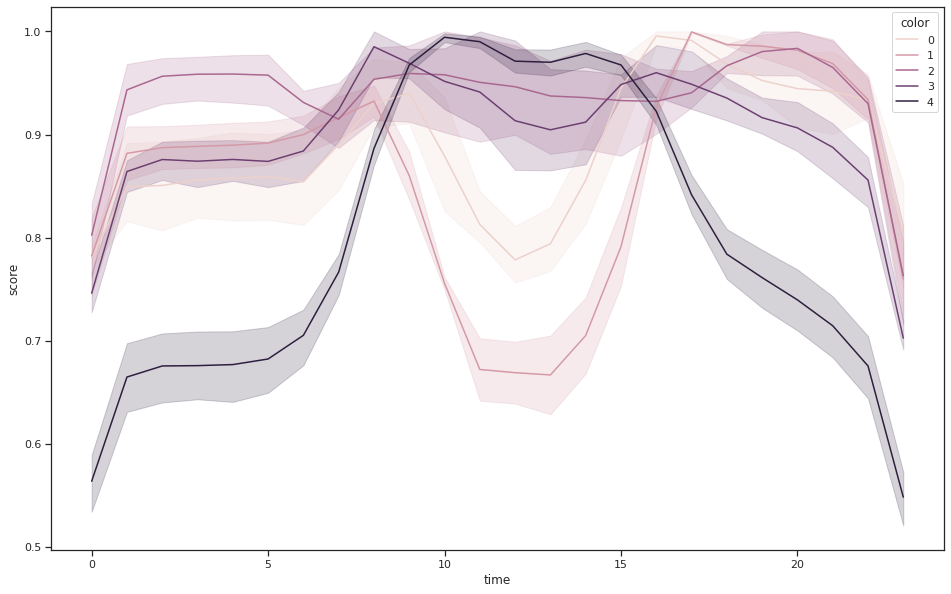

In [363]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
sns.lineplot(x="time", y="score",
            data=allDensity, hue = "color")

In [323]:
from sklearn.decomposition import PCA

In [324]:
# define transform
pca = PCA(n_components=2)
# prepare transform on dataset
pca.fit(vector_repr)
# apply transform to dataset
transformed = pca.transform(vector_repr)

In [336]:
pca.components_

array([[ 0.00324979,  0.00324979,  0.00324979,  0.00324979, -0.2539778 ,
        -0.26830429, -0.26615943, -0.26771931, -0.26680594, -0.26008065,
        -0.22420223, -0.16274197, -0.06521583,  0.03517692,  0.11012934,
         0.15038366,  0.14738281,  0.14696412,  0.12841327,  0.06298022,
        -0.03720182, -0.14604886, -0.21110307, -0.23628424, -0.25660381,
        -0.27102061, -0.28221126, -0.24353994],
       [-0.01608922, -0.01608922, -0.01608922, -0.01608922, -0.04666213,
        -0.15955181, -0.17893609, -0.17373354, -0.16854936, -0.15059006,
        -0.09639506, -0.03341241, -0.05119415, -0.14247483, -0.29491833,
        -0.42559319, -0.44555343, -0.42959901, -0.35031335, -0.20763977,
        -0.01403482,  0.05246555, -0.0134164 , -0.03218286, -0.04278188,
        -0.03297074, -0.01998579,  0.01479747]])

In [325]:
transformed

array([[-0.45987835,  0.10091883],
       [-0.75168931,  0.4114087 ],
       [-0.38798567,  0.16809588],
       [-0.66178379, -0.12705739],
       [-0.22337288, -0.19408014],
       [-0.58835031,  0.08178566],
       [-0.39172407, -0.05236626],
       [-0.41767548, -0.07706536],
       [-0.46100502, -0.29392684],
       [ 0.58801848,  0.05374259],
       [ 0.237491  , -0.07037547],
       [ 0.1875661 , -0.09100401],
       [ 0.61037978,  0.0536022 ],
       [ 0.29169626,  0.0329585 ],
       [ 0.38990832,  0.02824784],
       [ 0.33546407, -0.04096869],
       [-0.54832032, -0.26733374],
       [ 0.35240935,  0.06052615],
       [ 0.83712981,  0.12774044],
       [ 0.37162709,  0.02437174],
       [ 0.1717888 , -0.08068431],
       [ 0.10422722, -0.11895425],
       [ 0.52653773,  0.13214823],
       [ 0.20057879,  0.00181302],
       [ 0.02159528, -0.1393724 ],
       [-0.56132031,  0.34412296],
       [ 0.22668746, -0.06829389]])

In [326]:
res = pd.DataFrame(transformed)
res["2"] = pd.Series(cities)
res["cluster"] = pd.Series(db.labels_).astype(str).map(lambda t : t if t != "-1" else "Noise")

In [327]:
res

,0,1,2,cluster
0,-0.459878,0.100919,Saas-Fee,0
1,-0.751689,0.411409,Arosa,1
2,-0.387986,0.168096,Laax,0
3,-0.661784,-0.127057,Belp,2
4,-0.223373,-0.194080,Saanen,3
5,-0.588350,0.081786,Adelboden,0
6,-0.391724,-0.052366,Andermatt,3
7,-0.417675,-0.077065,Davos,3
8,-0.461005,-0.293927,Bulle,2
9,0.588018,0.053743,Bern,4


In [328]:
res = res.rename(columns={0: "v1", 1: "v2", "2": "city"})

In [329]:
res.head()

,v1,v2,city,cluster
0,-0.459878,0.100919,Saas-Fee,0
1,-0.751689,0.411409,Arosa,1
2,-0.387986,0.168096,Laax,0
3,-0.661784,-0.127057,Belp,2
4,-0.223373,-0.194080,Saanen,3


In [330]:

px.scatter(res, x="v1", y="v2", hover_data=["city"], color="cluster", labels="city")

In [132]:
cities

['Saas-Fee',
 'Arosa',
 'Laax',
 'Belp',
 'Saanen',
 'Adelboden',
 'Andermatt',
 'Davos',
 'Bulle',
 'Bern',
 'Genève',
 'Lausanne',
 'Zurich',
 'Neuchâtel',
 'Sion',
 'St. Gallen',
 'Appenzell',
 'Solothurn',
 'Zug',
 'Fribourg',
 'Luzern',
 'Ecublens (VD)',
 'Kloten',
 'Le Grand-Saconnex',
 'Nyon',
 'Zermatt',
 'Lugano']

In [133]:
len(cities)

27

In [135]:
preference = np.array([1,0,0,0,0,1,1,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0])

In [331]:
from sklearn.cluster import AffinityPropagation

af = AffinityPropagation(preference=-10).fit(transformed)
cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_
print('Estimated number of clusters: %d' % n_clusters_)
labels = af.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)


for n in range(-1, n_clusters_):
    print(f'Cluster {n}')
    for idx, c in enumerate(cities):
           if  af.labels_[idx] == n:
                print(c)

Estimated number of clusters: 5
Cluster -1
Cluster 0
Saas-Fee
Arosa
Laax
Belp
Saanen
Adelboden
Andermatt
Davos
Bulle
Bern
Genève
Lausanne
Zürich
Neuchâtel
Sion
St. Gallen
Appenzell
Solothurn
Zug
Fribourg
Luzern
Ecublens (VD)
Kloten
Le Grand-Saconnex
Nyon
Zermatt
Lugano


/home/jeremy/Documents/SwisscomMit/condaEnv/lib/python3.7/site-packages/sklearn/cluster/_affinity_propagation.py:152: FutureWarning:

'random_state' has been introduced in 0.23. It will be set to None starting from 0.25 which means that results will differ at every function call. Set 'random_state' to None to silence this warning, or to 0 to keep the behavior of versions <0.23.



# Junk

In [ ]:
from oauthlib.oauth2 import BackendApplicationClient
from requests_oauthlib import OAuth2Session
from datetime import datetime, timedelta
import pprint

BASE_URL = "https://api.swisscom.com/layer/heatmaps/demo"
TOKEN_URL = "https://consent.swisscom.com/o/oauth2/token"
MAX_NB_TILES_REQUEST = 100
headers = {"scs-version": "2"}  # API version

client_id = "Yzp9t1cBHslP9Y2pq9PvCTgpo29E1qbb"  # customer key in the Swisscom digital market place
client_secret = "BH5sruAbnzW5wZQv"  # customer secret in the Swisscom digital market place

# Fetch an access token
client = BackendApplicationClient(client_id=client_id)
oauth = OAuth2Session(client=client)
oauth.fetch_token(token_url=TOKEN_URL, client_id=client_id,
                  client_secret=client_secret)

In [ ]:
commune = pd.read_excel('commune.xlsx', sheet_name='GDE')

In [ ]:
@functools.lru_cache(maxsize=300)
def get_tiles(municipality):
    api_request = (
        BASE_URL
        + f'/grids/municipalities/{municipality}'
    )

    data = oauth.get(api_request, headers=headers).json()
    if(data.get('status') == None):
        tileID = [t['tileId'] for t in data['tiles']]
        ll_lon = [t['ll']['x'] for t in data['tiles']]
        ll_lat= [t['ll']['y'] for t in data['tiles']]
        ur_lon = [t['ur']['x'] for t in data['tiles']]
        ur_lat = [t['ur']['y'] for t in data['tiles']]
    else:
        print(f'git_tiles: failed with status code {data.get("status")}. {data.get("message")}')
        return pd.DataFrame(data={'tileID': [], 'll_lat': [], 'll_lon': [], 'ur_lat': [], 'ur_lon': []})
    
    return pd.DataFrame(data={'tileID': tileID, 'll_lat': ll_lat, 'll_lon': ll_lon, 'ur_lat': ur_lat, 'ur_lon': ur_lon})

In [ ]:
@functools.lru_cache(maxsize=128)
def get_municipalityID(name):
    return commune.loc[commune.GDENAME == name].GDENR.to_numpy()

In [ ]:
get_tiles(get_municipalityID("Lausanne")[0])['tileID'].to_numpy()